<a href="https://colab.research.google.com/github/reapbenefit/easyreport/blob/main/easyreport.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
#variables
github_repo = "github.com/reapbenefit/easyreport.git"
req = "/content/easyreport/pothole_detection/requirements.txt" 

# clone repo
# from getpass import getpass
# uname = getpass('Username')
# ename = getpass('Email ID:')
# password = getpass('Password:')
!git clone https://$github_repo

# install dependencies
!pip install -qr {req}
import torch
from zipfile import ZipFile 
from io import BytesIO
from IPython.display import Image, clear_output  # to display images
from easyreport.pothole_detection.utils.google_utils import gdrive_download  # to download models/datasets
import glob

#mapping
!pip install folium
import folium
import base64 
from IPython.display import IFrame

#exif
import PIL.Image
import os
from PIL.ExifTags import TAGS
from PIL.ExifTags import GPSTAGS

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Cloning into 'easyreport'...
remote: Enumerating objects: 28, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (26/26), done.
remote: Total 3496 (delta 3), reused 20 (delta 1), pack-reused 3468
Receiving objects: 100% (3496/3496), 199.85 MiB | 25.18 MiB/s, done.
Resolving deltas: 100% (2308/2308), done.
     |████████████████████████████████| 645kB 10.7MB/s 
Setup complete. Using torch 1.7.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


# Extract dataset

In [2]:
!mkdir dataset
%cd dataset
!wget -O images.zip https://www.dropbox.com/sh/ylc3dbasknxezm9/AABrWgaTjswiDrMhzwScZAXda?dl=1
with ZipFile("images.zip", 'r') as zip:
  zip.extractall()
  print("Unzipped file")
!rm images.zip
%cd /content/

/content/dataset
--2021-03-04 09:09:39--  https://www.dropbox.com/sh/ylc3dbasknxezm9/AABrWgaTjswiDrMhzwScZAXda?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.64.18, 2620:100:6020:18::a27d:4012
Connecting to www.dropbox.com (www.dropbox.com)|162.125.64.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /sh/dl/ylc3dbasknxezm9/AABrWgaTjswiDrMhzwScZAXda [following]
--2021-03-04 09:09:40--  https://www.dropbox.com/sh/dl/ylc3dbasknxezm9/AABrWgaTjswiDrMhzwScZAXda
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc7804a987981a3d00bd8679eece.dl.dropboxusercontent.com/zip_download_get/AtbElWqw6iOFrQWtE5857jW8Zej1hA3PbC9pPnf42J_5GUvtuTLrjTrAI-4Ag7EHw-leoEbUJTH3y70PdW9nEXNMCaOa13zLqwx_MFOwAJlJGw?dl=1 [following]
--2021-03-04 09:09:40--  https://uc7804a987981a3d00bd8679eece.dl.dropboxusercontent.com/zip_download_get/AtbElWqw6iOFrQWtE5857jW8Zej1hA3PbC9pPnf42J_5GUvtuTLrjTrAI-

#Run Inference  With Trained Weights


In [3]:
# use the best weights
!python /content/easyreport/pothole_detection/detect.py --weights /content/easyreport/pothole_detection/weights/best.pt --img 416 --conf 0.4 --source /content/dataset --save-txt --save-conf

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=True, save_txt=True, source='/content/dataset', update=False, view_img=False, weights=['/content/easyreport/pothole_detection/weights/best.pt'])
Using torch 1.7.1+cu101 CUDA:0 (Tesla P100-PCIE-16GB, 16280MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients
image 1/94 /content/dataset/Gautam - 02DEF733-B6FD-4E57-B16C-70653DFE6403.jpeg: 320x416 Done. (0.039s)
image 2/94 /content/dataset/Gautam - 0458EFC2-1D17-4D95-A680-EF27A3706EBC.jpeg: 416x256 3 potholes, Done. (0.028s)
image 3/94 /content/dataset/Gautam - 06337B11-F2C2-4FBE-996E-5462CF7D0A42.jpeg: 416x320 Done. (0.013s)
image 4/94 /content/dataset/Gautam - 0A3A2862-211A-4E99-A7C9-745DAA64A0C0.jpeg: 320x416 Done. (0.016s)
image 5/94 /content/dataset/Gautam - 0C50C967-9C59-41AA-B957-9487F42BDB3D.jpeg: 320x416 Done. (0.017s)
image 6/94

# Exif data

In [4]:
def get_labeled_exif(exif): #exif with labels
    labeled = {}
    for (key, val) in exif.items():
        labeled[TAGS.get(key)] = val
    return labeled

def get_decimal_from_dms(dms, ref):

    degrees = dms[0][0] / dms[0][1]
    minutes = dms[1][0] / dms[1][1] / 60.0
    seconds = dms[2][0] / dms[2][1] / 3600.0

    if ref in ['S', 'W']:
        degrees = -degrees
        minutes = -minutes
        seconds = -seconds

    return round(degrees + minutes + seconds, 5)

def get_coordinates(exif): #gps exif
    geotagging = {}
    for (idx, tag) in TAGS.items():
        if tag == 'GPSInfo':
            if idx not in exif:
              return 0
            for (key, val) in GPSTAGS.items():
                if key in exif[idx]:
                    geotagging[val] = exif[idx][key]

    lat = get_decimal_from_dms(geotagging['GPSLatitude'], geotagging['GPSLatitudeRef'])
    lon = get_decimal_from_dms(geotagging['GPSLongitude'], geotagging['GPSLongitudeRef'])

    return (lat,lon)
  

# Map

In [23]:
m = folium.Map()

for img_path in os.listdir("/content/dataset"):
  print(img_path)
  img = PIL.Image.open("/content/dataset/"+img_path)
  exif_data = img._getexif()
  location=get_coordinates(exif_data)
  if(location==0):
    continue
  icon = folium.Icon(color="blue", )
  for label_path in glob.glob("/content/runs/detect/exp/labels/*.txt"):
    if(label_path.split("/")[6] == img_path.split(".")[0]+".txt"):
      count=count+1
      icon = folium.Icon(color="red")
      break
  marker = folium.Marker(location=location, popup=img_path, icon=icon)
  marker.add_to(m)

m

Gautam - A56331BD-8C1B-47D8-9E78-4F32B2F1C7D9.jpeg
Gautam - 225E9100-C16F-4BB6-B3B8-065B5AA083DB.jpeg
Gautam - 37BD6174-4873-4C05-8482-33567F1BD0FD.jpeg
Gautam - 9A926E07-AAF9-4690-90E9-BFCFCC5DE4E0.jpeg
Gautam - 1B17B8EB-224E-4038-9F29-B3E0B84D239C.jpeg
Gautam - 7F279DDF-CA21-48B9-8B3A-C1E06FAFA842.jpeg
Gautam - BE1069EE-CC18-451F-BBCA-5A91AEA567DD.jpeg
Gautam - 7D775C3F-9BD4-4A87-8BE3-5090439B5401.jpeg
Gautam - 77E17340-DC13-4209-843B-B74FBECA8D59.jpeg
Gautam - 7E5D2D51-A526-43EB-8C0D-13B136CBAE33.jpeg
Gautam - F341E6D3-978C-463E-9235-594E9155BF66.jpeg
Gautam - 0A3A2862-211A-4E99-A7C9-745DAA64A0C0.jpeg
Gautam - 4A6FD08A-7477-4AB0-B9A9-7E28A14E4F5C.jpeg
Rakshit Jain - PXL_20210217_093027523.jpg
Gautam - F80926AE-017E-41A0-B5B5-663993F26484.jpeg
Gautam - FADF1A5C-9DFE-4BF9-8146-56235336EBA5.jpeg
Gautam - 51D68B6E-63DD-470D-8C24-47410DECD394.jpeg
Gautam - E671480E-F57F-4C46-AE7E-CD627ED7AEA4.jpeg
Gautam - 0FA31A77-C9BD-45BE-9871-952D31CDED42.jpeg
Gautam - F9A433A2-1EAF-4691-8B47-D15CA21

# Display inference

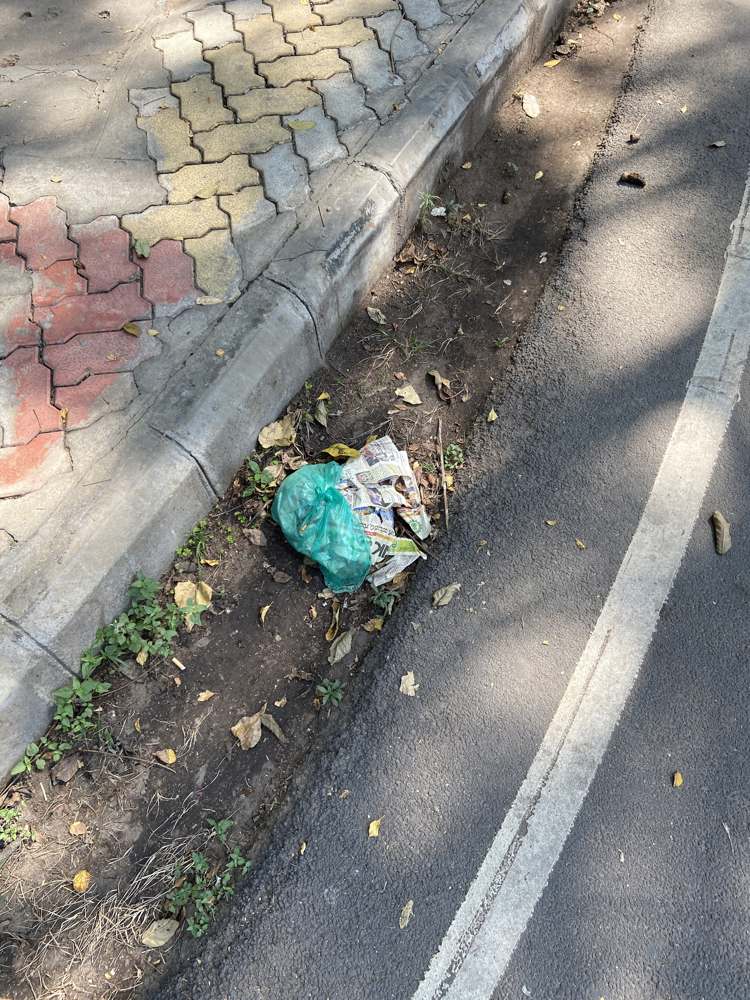

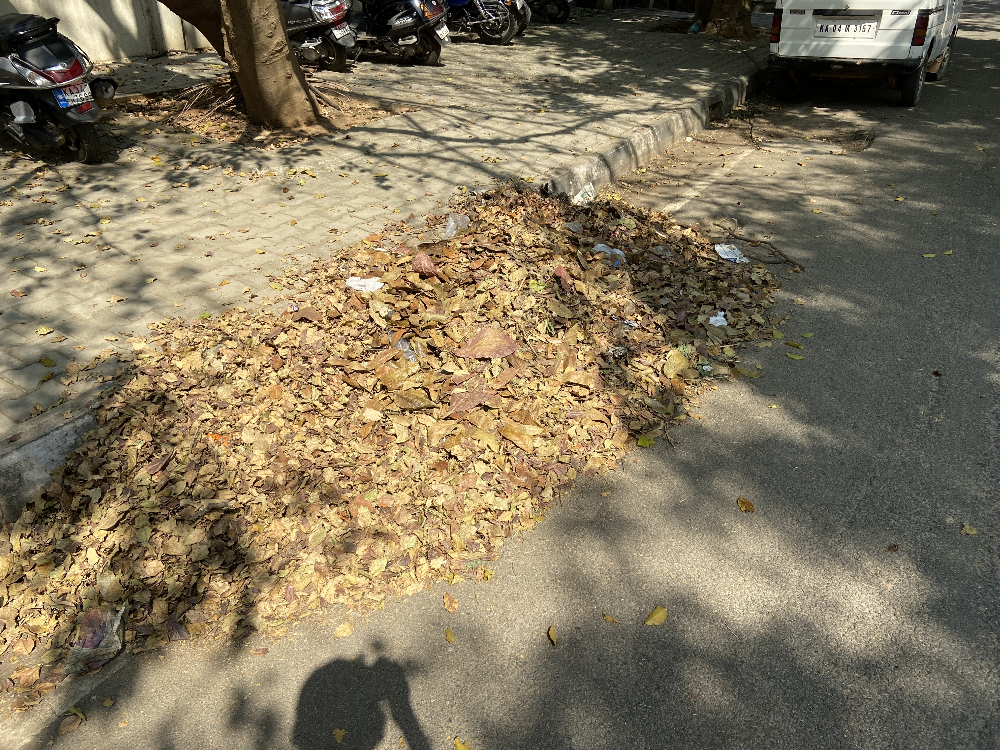

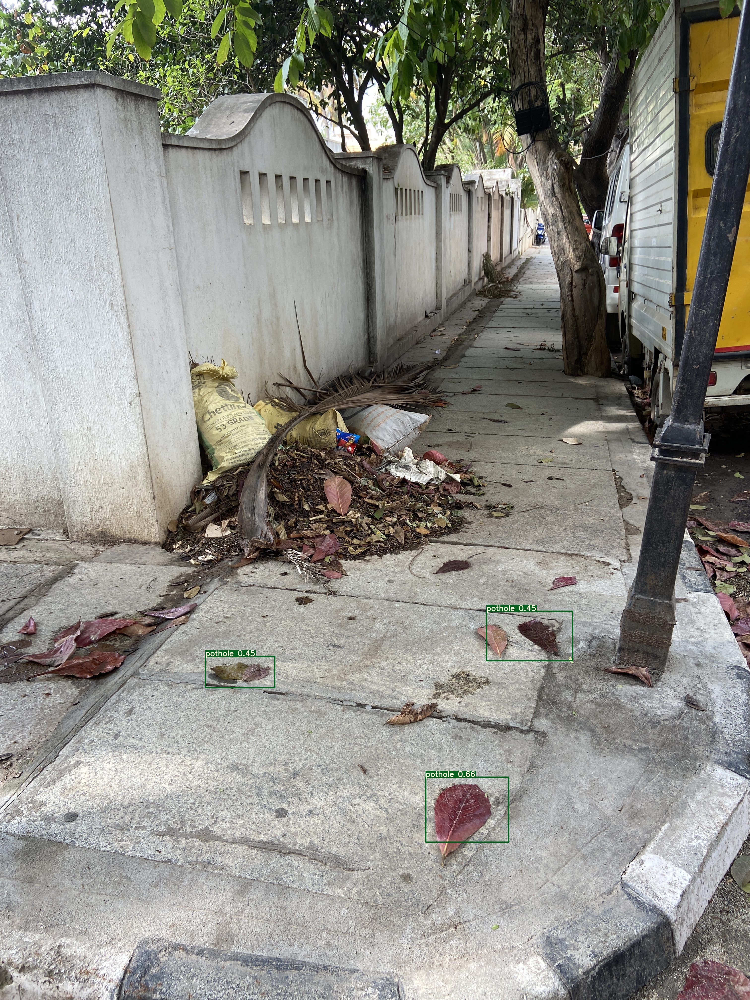

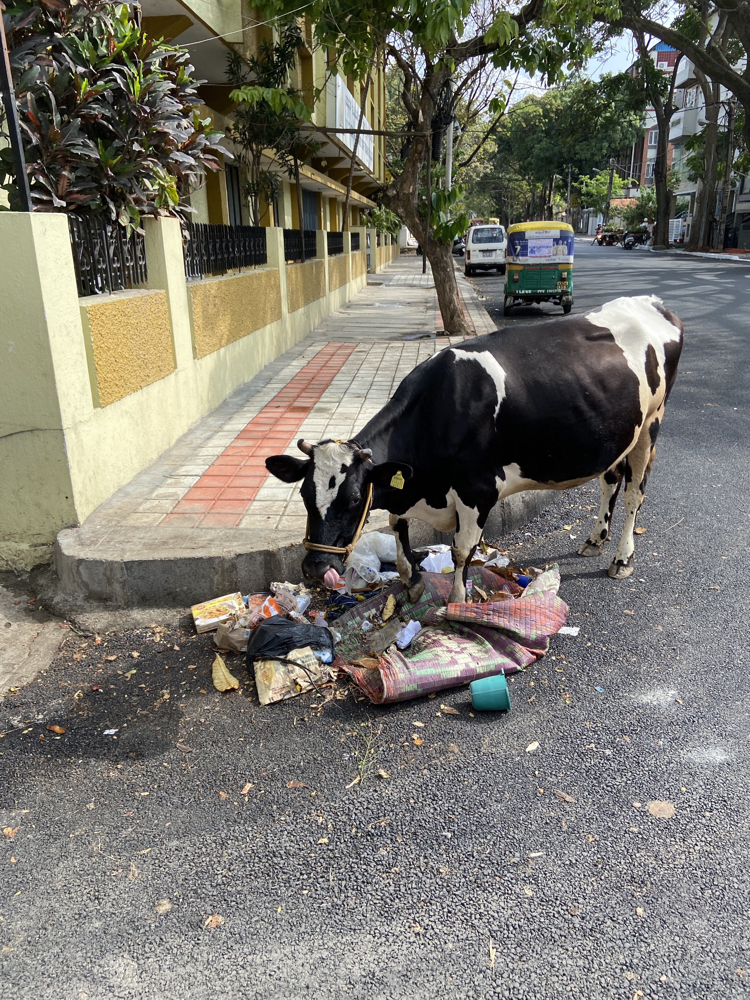

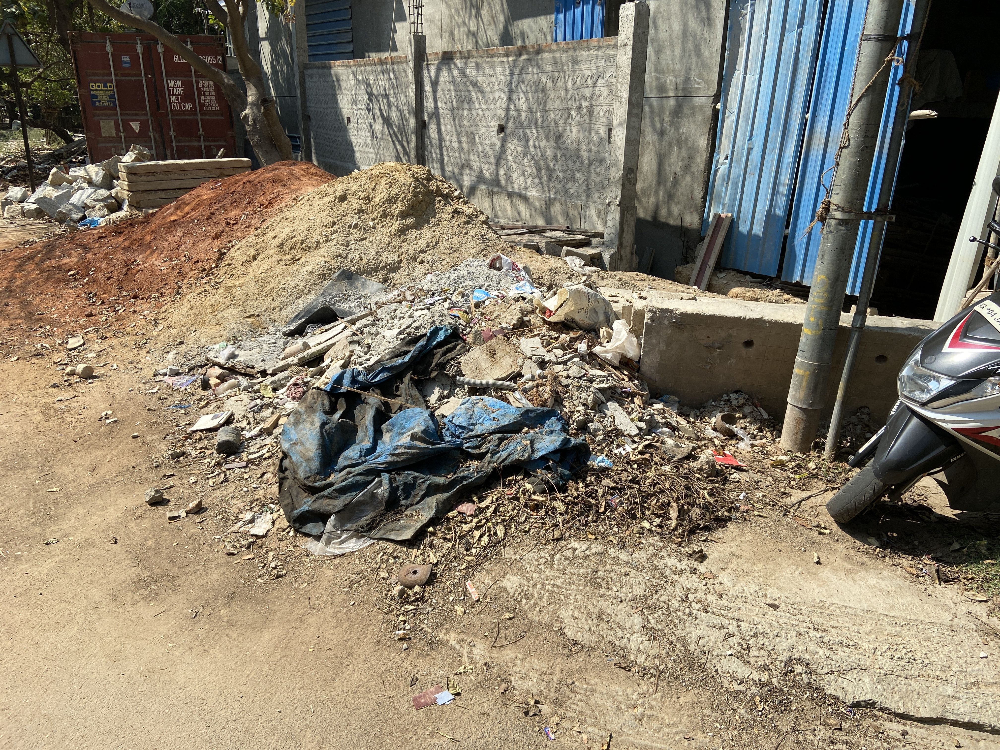

Buffered data was truncated after reaching the output size limit.

In [ ]:
#display inference on ALL images
import glob
from IPython.display import Image, display

for imageName in os.listdir('/content/runs/detect/exp/'): 
    display(Image(filename='/content/runs/detect/exp/'+imageName, width=400, height=400))